In [1]:
import scipy
import warnings

import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import scanpy as sc
import seaborn as sns
# import seaborn.objects as so
import symphonypy as sp

from ete3 import TreeStyle, Tree, TextFace, add_face_to_node

sc.set_figure_params(dpi=300, scanpy=True)
sc.settings.verbosity = 3
warnings.simplefilter(action='ignore', category=pd.errors.PerformanceWarning)
warnings.simplefilter(action='ignore', category=FutureWarning)

In [2]:
import os
# change it according to your preferences
DATA_DIR = "/n/groups/kirschner/xenopus/old_atlas"
NF_stage = "S10"
# adata_kotov_fp = os.path.join(DATA_DIR, "GSE198491_matrix.h5ad")
# adata_train_fp = os.path.join(DATA_DIR, "adata", f"all.{NF_stage}.realigned.corrected.transferred.kNN.h5ad")
adata_fp = os.path.join(DATA_DIR, "adata", f"all.{NF_stage}.realigned.corrected.transferred.h5ad")
# adata_fp = os.path.join(DATA_DIR, "adata", f"all.{NF_stage}.realigned.corrected.transferred.clustered.reannotated.h5ad")


os.environ['QT_QPA_PLATFORM']='offscreen'

In [3]:
import sys
sys.path.append("/home/ksp503/projs/xenopus/notebooks")

from little import *

In [4]:
# adata.uns['log1p']["base"] = None

# DE marker gene determination for Briggs cell types

In [4]:
adata = sc.read_h5ad(adata_fp)

In [5]:
REF_DIR = "/n/groups/kirschner/xenopus/reference/Xentr10.0"

gtf_ids = pd.read_csv(os.path.join(REF_DIR, "XENTR_10.0_Xenbase.names.tsv"), sep="\t")
gtf_ids[["eval_forward", "eval_backward"]] = gtf_ids[["eval_forward", "eval_backward"]].astype(float)
gtf_ids_unique = gtf_ids.sort_values("eval_forward").drop_duplicates("gene_id")
cols = ["gene_name", "human_id", "human_name", "human_desc", "eval_forward", "eval_backward"]
adata.var[cols] = gtf_ids_unique.set_index("gene_id").loc[adata.var_names, cols].values
adata.var[["eval_forward", "eval_backward"]] = adata.var[["eval_forward", "eval_backward"]].astype(float)

In [9]:
adata[:,adata.var.gene_name == "dzip1"].X.sum(axis=0) # g014797

matrix([[1563.]], dtype=float32)

In [16]:
adata.var.loc[adata.var.gene_name == "dzip1",:]

,n_cells,gene_name,human_id,human_name,human_desc,eval_forward,eval_backward,mt,ribo,n_cells_by_counts,...,total_counts,log1p_total_counts,highly_variable,highly_variable_rank,means,variances,variances_norm,highly_variable_nbatches,residual_variances,highly_variable_intersection
XBXT10g014797,1188,dzip1,sp|Q86YF9|DZIP1_HUMAN,DZIP1,Zinc finger protein DZIP1,2.000000e-117,1.100000e-110,False,False,1188,...,1582.0,7.367077,False,NaN,0.073099,0.119113,0.935203,0,0.877193,False


In [10]:
adata.raw = adata.copy()

In [6]:
adata.obs["Celltype_transferred"].value_counts()

Celltype_transferred
Unknown                             14933
S10-neuroectoderm                    2023
S10-non-neural ectoderm              1742
S10-marginal zone                    1561
Outlier                               569
S10-Spemann organizer (endoderm)      317
S10-Spemann organizer (mesoderm)      133
S10-endoderm                           99
S10-germ cell                           5
Name: count, dtype: int64

In [11]:
unlabeled = "Unlabeled"

reannotate_dict = {
    "germ cell": unlabeled,
    "Unknown": unlabeled,
    "Outlier": unlabeled
}

train_target_long = "Celltype_transferred"
# adata_train.obs[train_target] = adata_train.obs["Celltype_transferred"].astype("str")
# adata_train.obs.loc[~adata_train.obs.consistent, train_target] = "Unknown"

train_target = f"{train_target_long}_short"
adata.obs[train_target] = adata.obs[train_target_long].str.replace(f"{NF_stage}-", "")
adata.obs[train_target] = adata.obs[train_target].astype("category")

celltype_barcode = "Celltype_barcode"
adata.obs[celltype_barcode] = adata.obs[train_target]

adata.obs[train_target] = [reannotate_dict[ct] if ct in reannotate_dict else ct for ct in adata.obs[train_target]]
adata.obs[train_target] = adata.obs[train_target].astype("category")

In [12]:
adata.obs_names_make_unique()

In [84]:
# adata = adata.raw.to_adata()

In [13]:
sc.experimental.pp.recipe_pearson_residuals(adata, n_top_genes=3000, theta=10, batch_key="Library_name", n_comps=30)

extracting highly variable genes
--> added
    'highly_variable', boolean vector (adata.var)
    'highly_variable_rank', float vector (adata.var)
    'highly_variable_nbatches', int vector (adata.var)
    'highly_variable_intersection', boolean vector (adata.var)
    'means', float vector (adata.var)
    'variances', float vector (adata.var)
    'residual_variances', float vector (adata.var)
computing analytic Pearson residuals on adata.X
    finished (0:00:02)
computing PCA
    on highly variable genes
    with n_comps=30
    finished (0:00:11)


In [14]:
adata.raw = adata.copy()

In [15]:
sc.pp.normalize_total(adata, target_sum=1e5)
sc.pp.log1p(adata)
sc.pp.neighbors(adata)
sc.tl.umap(adata)

normalizing counts per cell
    finished (0:00:00)
computing neighbors
    using 'X_pca' with n_pcs = 30


2024-11-25 12:44:03.387533: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcudart.so.11.0'; dlerror: libcudart.so.11.0: cannot open shared object file: No such file or directory
2024-11-25 12:44:03.387602: I tensorflow/stream_executor/cuda/cudart_stub.cc:29] Ignore above cudart dlerror if you do not have a GPU set up on your machine.


    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:04:42)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:29)


In [12]:
res = 1
cur_leiden = f"leiden_{res}"
sc.tl.leiden(adata, resolution=res, key_added=cur_leiden)

running Leiden clustering
    finished: found 31 clusters and added
    'leiden_1', the cluster labels (adata.obs, categorical) (0:00:04)


/home/ksp503/.conda/envs/xenopus/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


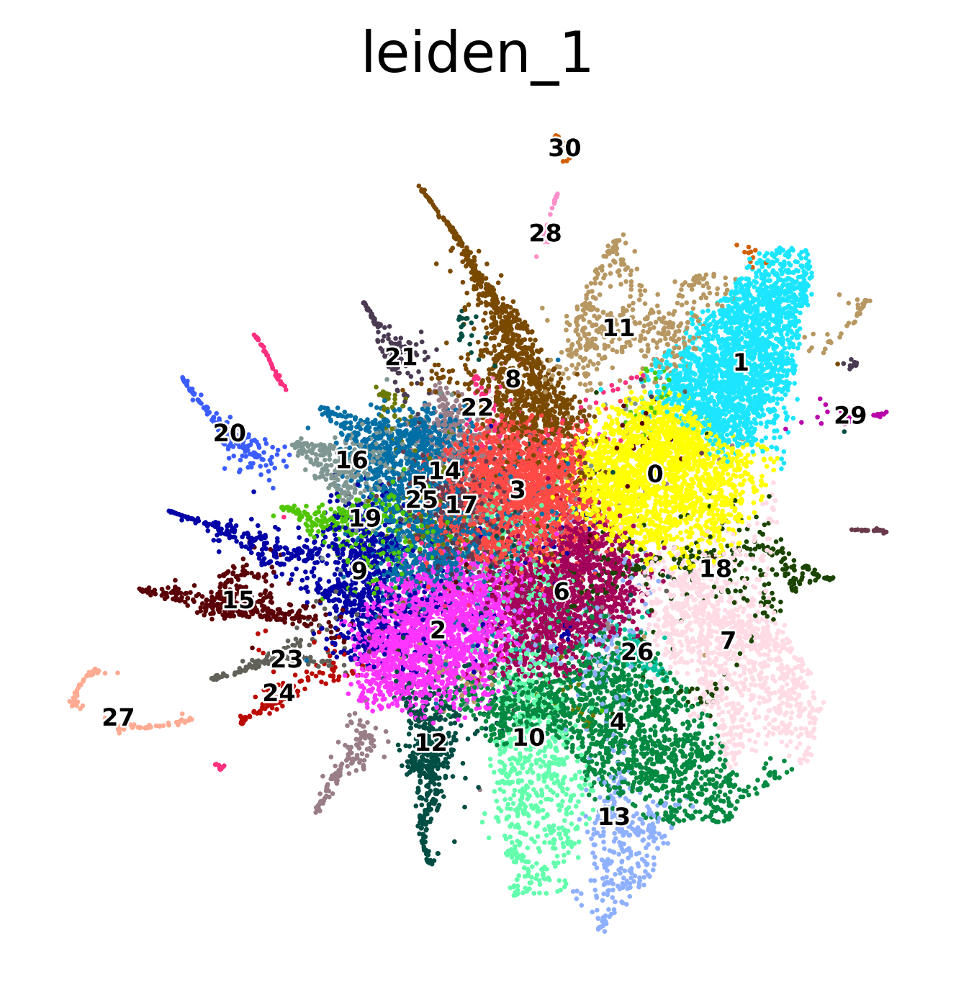

In [13]:
sc.set_figure_params(dpi=200)
sc.pl.umap(
    adata,
    color=cur_leiden,
    legend_loc="on data",
    legend_fontsize=6,
    legend_fontoutline=1,
    frameon=False,
)

# Cell type prediction

In [14]:
infer_groups = [unlabeled, ]
adata_test = adata 
adata_train = adata[~adata.obs[train_target].isin(infer_groups)]

In [15]:
adata.var["gene_id"] = adata.var_names.to_series()

In [16]:
p_adj = 0.05
method = "wilcoxon"
pct = 0.2
n_top = 30
use_raw = False
logfoldchange = 2
labels = adata_train.obs[train_target].cat.categories
gene_symbols = "gene_id"

de_params = {
    "log_foldchange": logfoldchange,
    "p_adj": p_adj,
    "method": method,
    "n_top": n_top,
    "pct": pct
}

celltype_collection = get_celltype_collection(adata_train, train_target, de_params)
celltype_gsea_results = run_GSEA(adata_test, cur_leiden, de_params, gene_symbols, celltype_collection)

celltype_by_cluster = {
    cluster: celltype_gsea_results[cluster].sort_values(["score"]).iloc[-1,:] \
        for cluster in adata_test.obs[cur_leiden].cat.categories
    }

predicted_best = [celltype_by_cluster[cluster].name for cluster in adata_test.obs[cur_leiden]]

ranking genes


/home/ksp503/.conda/envs/xenopus/lib/python3.10/site-packages/scanpy/tools/_rank_genes_groups.py:580: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[key_added] = {}


    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:15)
Spemann organizer (mesoderm) 30
marginal zone 30
neuroectoderm 7
Spemann organizer (endoderm) 30
non-neural ectoderm 19
endoderm 27
ranking genes
    finished: added to `.uns['leiden_1']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:48)


### celltype scores by cluster:

In [17]:
celltypes_by_cluster = {
    celltype: {
        cluster: celltype_gsea_results[cluster].loc[celltype, "norm"] \
        for cluster in adata_test.obs[cur_leiden].cat.categories
    }
    for celltype in celltype_collection.geneset.unique()
    }

for celltype, cluster_scores in celltypes_by_cluster.items():
    adata.obs[celltype] = [cluster_scores[cluster] for cluster in adata.obs[cur_leiden]]

### celltype best by cluster:

In [18]:
inferred_target = "Celltype_by_cluster"
adata.obs[inferred_target] = predicted_best
adata.obs[inferred_target] = adata.obs[inferred_target].astype("category")

In [19]:
crosstab = pd.crosstab(adata.obs[celltype_barcode], adata.obs[inferred_target])
crosstab = crosstab.div(crosstab.sum(axis=1), axis=0)

In [20]:
sc.tl.dendrogram(adata, groupby=celltype_barcode, use_rep="X_pca")
row_linkage = adata.uns[f"dendrogram_{celltype_barcode}"]["linkage"]

sc.tl.dendrogram(adata, groupby=inferred_target, use_rep="X_pca")
column_linkage = adata.uns[f"dendrogram_{inferred_target}"]["linkage"]

Storing dendrogram info using `.uns['dendrogram_Celltype_barcode']`
Storing dendrogram info using `.uns['dendrogram_Celltype_by_cluster']`


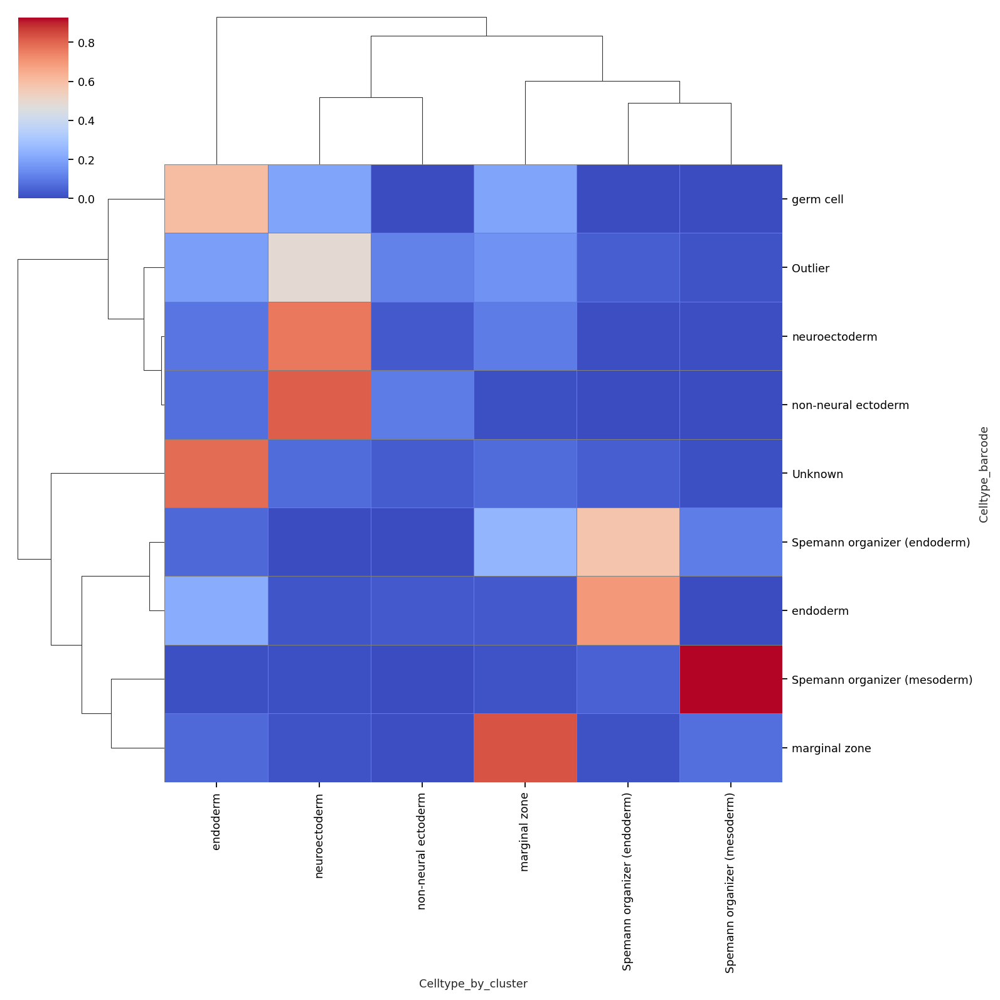

In [21]:
with sns.axes_style("ticks"):
    sc.set_figure_params(scanpy=True, fontsize=8)
    # fig, ax = plt.subplots(figsize=(8, 8))
    # g = sns.heatmap(
    g = sns.clustermap(
        crosstab,
        cmap="coolwarm",
        yticklabels=adata.obs[celltype_barcode].cat.categories,
        xticklabels=adata.obs[inferred_target].cat.categories,
        row_linkage=row_linkage,
        col_linkage=column_linkage,
        # ax=ax,
        linewidths=.3,
    #     row_cluster=False,
        linecolor='grey',
    #     square=True,
        # cbar_pos=(0.05, 0.87, 0.025, 0.1)
    #     cbar=False,
    )

In [22]:
abundance_table = pd.concat(
    [
        adata_train.obs[train_target].value_counts(),
        adata.obs[inferred_target].value_counts()
    ],
    axis=1
)
abundance_table.columns = [train_target, inferred_target]
abundance_table = abundance_table.fillna(0).astype(int)
abundance_table

,Celltype_transferred_short,Celltype_by_cluster
neuroectoderm,2023,4239
non-neural ectoderm,1742,864
marginal zone,1561,2682
Spemann organizer (endoderm),317,868
Spemann organizer (mesoderm),133,431
endoderm,99,12298


In [25]:
abundance_table.sum(axis=0)

Celltype_transferred_short     5875
Celltype_by_cluster           21382
dtype: int64

# Leiden cluster annotation with Briggs DE gene markers

/home/ksp503/.conda/envs/xenopus/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/ksp503/.conda/envs/xenopus/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


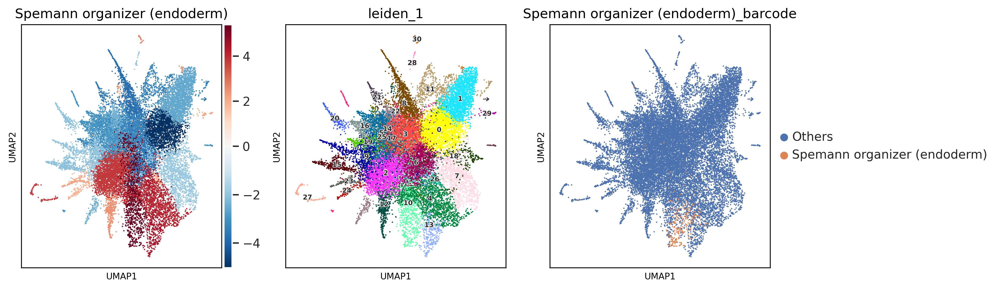

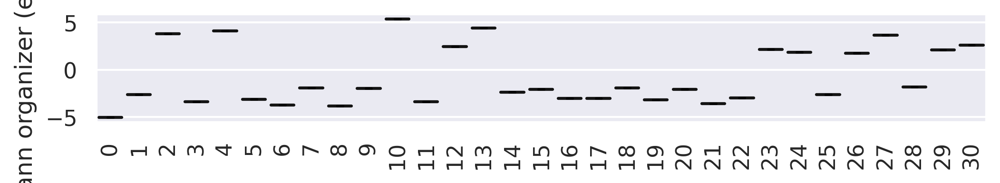

In [23]:
sc.set_figure_params(dpi=150, scanpy=True, fontsize=8)
fig, axs = plt.subplots(1, 3, figsize=(12, 4))
ct = f'Spemann organizer (endoderm)'
ct_barcode = ct + "_barcode"

adata.obs[ct_barcode] = adata.obs[celltype_barcode] == ct
adata.obs.loc[adata.obs[ct_barcode], ct_barcode] = ct
adata.obs.loc[~adata.obs[ct_barcode].astype(bool), ct_barcode] = "Others"

sns.set(font_scale = 1)
sc.pl.umap(
    adata, color=ct, cmap='RdBu_r', vcenter=0, legend_loc="on data", legend_fontsize=6,
    legend_fontoutline=1, ax=axs[0], show=False)

sc.pl.umap(
    adata, color=cur_leiden, legend_loc="on data", legend_fontsize=6,
    legend_fontoutline=1, ax=axs[1], show=False)

sc.pl.umap(
    adata, color=ct_barcode, ax=axs[2])

fig, ax = plt.subplots(figsize=(8, 1))
# sns.set(font_scale = 0.3)
ax = sc.pl.violin(adata, keys=[ct], groupby=cur_leiden, rotation=90, ax=ax)

/home/ksp503/.conda/envs/xenopus/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/ksp503/.conda/envs/xenopus/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


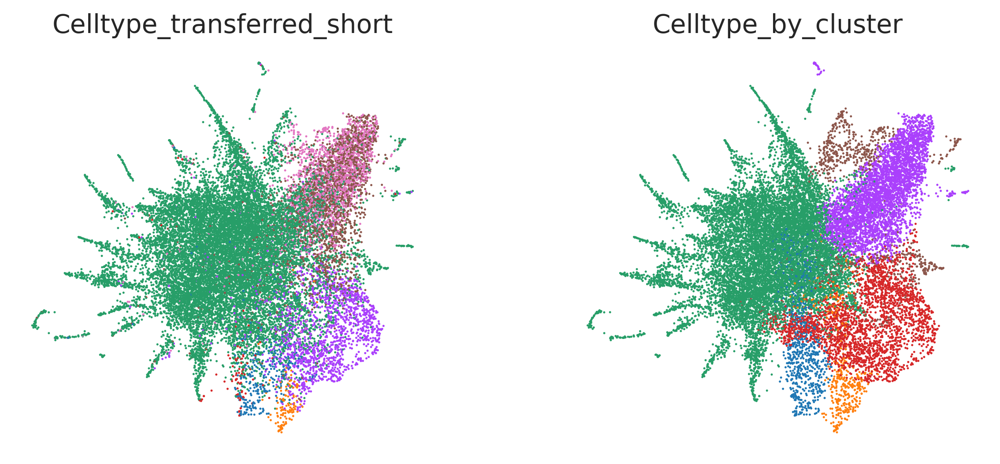

In [24]:
sc.set_figure_params(dpi=150, scanpy=True)

sc.pl.umap(
    adata,
    color=[train_target,  inferred_target], 
    frameon=False,
    legend_loc=None
)

# Checkpoint

In [26]:
adata_fp = os.path.join(DATA_DIR, "adata", f"all.{NF_stage}.realigned.corrected.transferred.clustered.reannotated.h5ad")
adata.write(adata_fp)

In [27]:
adata

AnnData object with n_obs × n_vars = 43193 × 21868
    obs: 'lib', 'nUMI_per_cell', 'ngenes_per_cell', 'inDrops_version', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'cell_barcode', 'cell_barcode_v', 'Library_name', 'barcodes_unique', 'Celltype_transferred', 'Celltype_known', 'Celltype_transferred_short', 'Celltype_barcode', 'leiden_2', 'non-neural ectoderm', 'ionocyte', 'chordal neural plate', 'goblet cell', 'endoderm', 'dorsal / presomitic mesoderm', 'cement gland primordium', 'ciliated epidermal progenitor', 'pre-chordal neural plate', 'involuted ventral mesoderm', 'neural crest', 'Spemann organizer (endoderm)', 'tail bud', 'notochord', 'placodal area', 'early neuron', 'eye primordium', 'Celltyp

# Assessment of annotation of clusters
- celltype entropy -> undetermined cluster
- number of strong marker genes ~ cluster goodness
- fraction of celltype max -> subtype?

/home/ksp503/.conda/envs/xenopus/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/ksp503/.conda/envs/xenopus/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


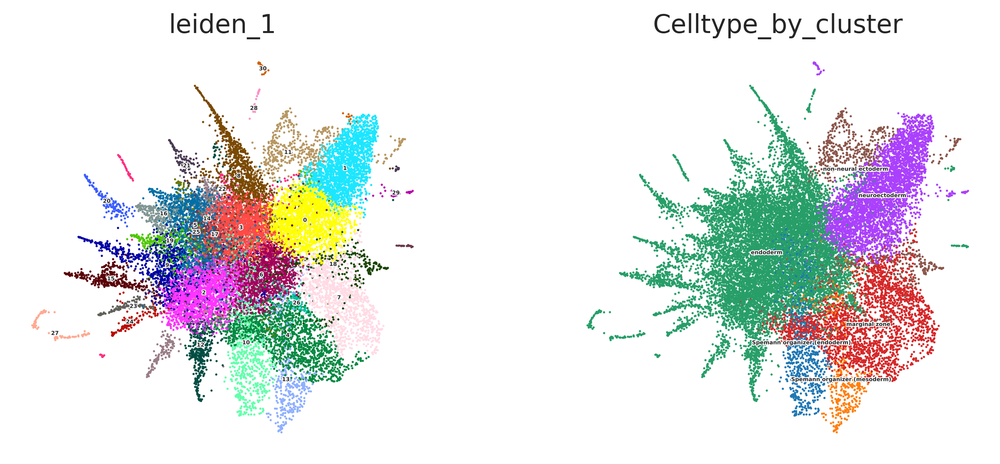

In [25]:
# res = 2
# cur_leiden = f"leiden_{res}"
# sc.tl.leiden(adata, resolution=res, key_added=cur_leiden)
sc.set_figure_params(dpi=200)
sc.pl.umap(
    adata,
    color=[cur_leiden, inferred_target],
    legend_loc="on data",
    legend_fontsize=3,
    legend_fontoutline=1,
    frameon=False,
)

/home/ksp503/.conda/envs/xenopus/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


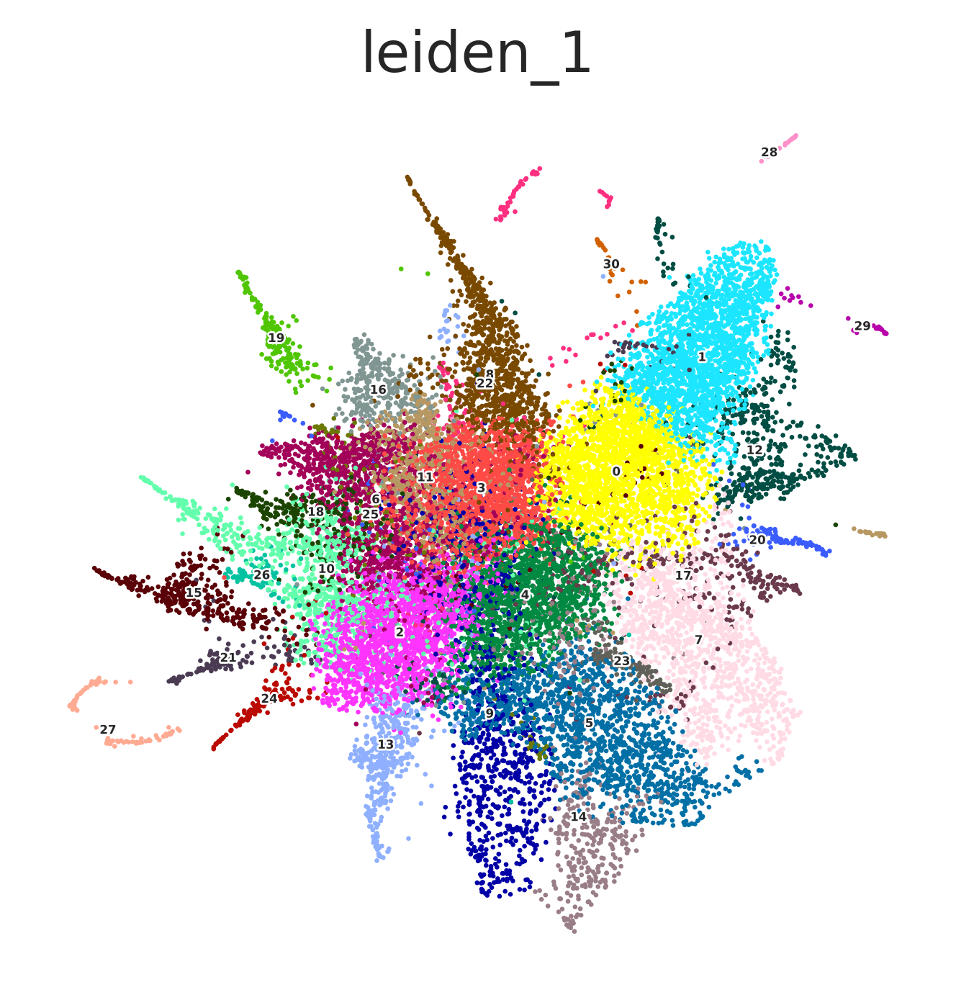

In [28]:
sc.set_figure_params(dpi=200)
sc.pl.umap(
    adata,
    color=[cur_leiden,],
    legend_loc="on data",
    legend_fontsize=3,
    legend_fontoutline=1,
    frameon=False,
)

In [26]:
gene_name = "gene_name_display"
adata.var[gene_name] = adata.var.gene_id.astype("str")
idx = ~adata.var.gene_name.isna()
adata.var.loc[idx, gene_name] += "|" + adata.var.loc[idx, "gene_name"].astype("str")
idx = ~adata.var.human_name.isna()
adata.var.loc[idx, gene_name] += "|" + adata.var.loc[idx, "human_name"].astype("str")

adata.var[gene_name]

XBXT10g000001        XBXT10g000001|nsfl1c|NSFL1C
XBXT10g000002          XBXT10g000002|clul1|CLUL1
XBXT10g000003          XBXT10g000003|vwc2l|VWC2L
XBXT10g000004      XBXT10g000004|slc47a1|SLC47A1
XBXT10g000005          XBXT10g000005|ikbkg|IKBKG
                              ...               
XBXT10g029560    XBXT10g029560|LOC116406866|CRNN
XBXT10g029565         XBXT10g029565|LOC116412448
XBXT10g029569         XBXT10g029569|LOC105945488
XBXT10g029570      XBXT10g029570|crygdl.43|CRYGB
XBXT10g029573         XBXT10g029573|LOC105947954
Name: gene_name_display, Length: 22231, dtype: object

In [27]:
celltypes_vs_clusters_unnorm = pd.crosstab(
    adata.obs[inferred_target],
    adata.obs[cur_leiden],
    dropna=False
)
celltypes_vs_clusters_by_celltype = celltypes_vs_clusters_unnorm.values / celltypes_vs_clusters_unnorm.values.sum(axis=1, keepdims=True)
celltypes_vs_clusters_by_cluster = celltypes_vs_clusters_unnorm.values / celltypes_vs_clusters_unnorm.values.sum(axis=0, keepdims=True)

In [28]:
method = "wilcoxon"
logfoldchange = 2
p_adj = 0.05
pct = 0.8

sc.tl.rank_genes_groups(adata, cur_leiden, method=method, use_raw=False, key_added=cur_leiden, pts=True)

ranking genes
    finished: added to `.uns['leiden_1']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:57)


In [29]:
cluster_marker_genes = {}

for cluster in adata.obs[cur_leiden].cat.categories:
    mg_df = sc.get.rank_genes_groups_df(adata, group=cluster, key=cur_leiden)
    mg_df = mg_df.loc[(mg_df.logfoldchanges > logfoldchange) & (mg_df.pvals_adj < p_adj) & (mg_df.pct_nz_group > pct)]
    cluster_marker_genes[cluster] = mg_df

In [30]:
cluster2cell_type = pd.DataFrame(
    {
        "cluster": adata.obs[cur_leiden].cat.categories,
        "celltype_max":  adata.obs[inferred_target].cat.categories[celltypes_vs_clusters_by_cluster.argmax(axis=0)],
        "celltype_max_frac": celltypes_vs_clusters_by_celltype[celltypes_vs_clusters_by_cluster.argmax(axis=0)].diagonal(),
        "celltype_entropy": scipy.stats.entropy(celltypes_vs_clusters_by_cluster, axis=0),
        f"mg_num_{logfoldchange}_{p_adj}_{pct}": [cluster_marker_genes[cluster].shape[0] for cluster in adata.obs[cur_leiden].cat.categories]
    }
)

In [31]:
with pd.option_context('display.max_rows', None,
                       'display.max_columns', None,
                       'display.precision', 3,
                       ):
    display(cluster2cell_type.sort_values(f"mg_num_{logfoldchange}_{p_adj}_{pct}"))

,cluster,celltype_max,celltype_max_frac,celltype_entropy,mg_num_2_0.05_0.8
30,30,neuroectoderm,0.008,0.0,0
17,17,endoderm,0.028,0.0,0
16,16,endoderm,0.029,0.0,0
21,21,endoderm,0.014,0.0,0
14,14,endoderm,0.034,0.0,0
22,22,endoderm,0.012,0.0,0
23,23,endoderm,0.012,0.0,0
11,11,non-neural ectoderm,0.620,0.0,0
10,10,Spemann organizer (endoderm),1.000,0.0,0
9,9,endoderm,0.074,0.0,0


In [64]:
adata.var.loc[adata.var.human_name == "CHRD",:]

,n_cells,gene_name,human_id,human_name,human_desc,eval_forward,eval_backward,mt,ribo,n_cells_by_counts,...,highly_variable,highly_variable_rank,means,variances,variances_norm,highly_variable_nbatches,residual_variances,highly_variable_intersection,gene_id,gene_name_display
XBXT10g018107,1915,chrd.1,sp|Q9H2X0|CHRD_HUMAN,CHRD,Chordin,8.900000e-280,5.100000e-278,False,False,1915,...,True,59.0,0.244224,2.568105,4.453703,3,5.156011,True,XBXT10g018107,XBXT10g018107|chrd.1|CHRD


In [17]:
genes = ["ddx25", "dazl", "sybu", "dnd1", "nog", "nog2", "chga", "sox17a", "sox17b.2", "sox17b.1", "chrd.1", "dzip1"]
color = adata.var_names[adata.var["gene_name"].isin(genes)]
names = adata.var.loc[adata.var["gene_name"].isin(genes), "gene_name"].astype("str") + "|" \
    + adata.var.loc[adata.var["gene_name"].isin(genes), "human_name"].astype("str")
sc.pl.umap(adata, color=color, frameon=False, ncols=3, use_raw=False, title=names)

# Cluster explore

In [69]:
sc.tl.rank_genes_groups(
    adata, cur_leiden, method='wilcoxon', use_raw=False,
)

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:34)


In [50]:
groups = ["16", ]
reference = "13"
key_added = f"{','.join(groups)} vs {reference}"

In [51]:
sc.tl.rank_genes_groups(
    adata, cur_leiden, method='wilcoxon', use_raw=False,
    groups=groups,
    reference=reference,
    key_added=key_added
)

ranking genes
    finished: added to `.uns['16 vs 13']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:03)


In [52]:
gene_symbols = "gene_name_display"
marker_genes = sc.get.rank_genes_groups_df(adata, group=groups, gene_symbols=gene_symbols, key=cur_leiden)

In [ ]:
sc.set_figure_params(dpi=150)
ntop = nbottom = 5
use_raw = True

adata.obs["cur_cluster"] = "others"

marker_genes_top = []
marker_genes_bottom = []
marker_genes_top_symbols = []
marker_genes_bottom_symbols = []

if len(groups) > 1:
    for group in groups:
        adata.obs.loc[adata.obs[cur_leiden] == group, "cur_cluster"] = f"group_{group}"
        marker_genes_top += list(marker_genes.loc[marker_genes.group == group, "names"][:ntop])
        marker_genes_top_symbols += list(marker_genes.loc[marker_genes.group == group, gene_symbols][:ntop])
        marker_genes_bottom += list(marker_genes.loc[marker_genes.group == group, "names"][-nbottom:])
        marker_genes_bottom_symbols += list(marker_genes.loc[marker_genes.group == group, gene_symbols][-nbottom:])
else:
    adata.obs.loc[adata.obs[cur_leiden] == groups[0], "cur_cluster"] = f"group_{groups[0]}"
    marker_genes_top += list(marker_genes["names"][:ntop])
    marker_genes_top_symbols += list(marker_genes[gene_symbols][:ntop])
    marker_genes_bottom += list(marker_genes["names"][-nbottom:])
    marker_genes_bottom_symbols += list(marker_genes[gene_symbols][-nbottom:])
    
adata.obs.loc[adata.obs[cur_leiden] == reference, "cur_cluster"] = f"reference_{reference}"

    
colors = ["cur_cluster"] + marker_genes_top + marker_genes_bottom 
titles = [key_added] + marker_genes_top_symbols + marker_genes_bottom_symbols

sc.pl.umap(
    adata,
    color=colors,
    title=titles,
    frameon=False,
    ncols=3,
    use_raw=use_raw
#     vmax=[30, 10, 40, 20]
)

In [51]:
adata.obs.loc[adata.obs[cur_leiden].isin(groups+[reference,]), [cur_leiden, celltype_barcode]].value_counts().sort_index()

leiden_3  Celltype_barcode                 
19        S18-chordal neural crest              80
          S18-cranial neural crest             276
          Unknown                                2
53        Outlier                                1
          S18-anterior placodal area             1
          S18-chordal neural crest               5
          S18-cranial neural crest              79
          S18-endoderm / foregut primordium      1
          Unknown                                4
Name: count, dtype: int64

In [ ]:
def find_genes(adata, names_column, gene_names):
    id_2_name = {}
    
    for gene in gene_names:
        genes = adata.var.loc[adata.var[names_column].str.contains(gene, case=False, na=False), :]
        for i, gene in genes.iterrows():
            id_2_name[i] = gene[names_column]
    
    return id_2_name

In [97]:
gene_symbols = "gene_name_display"
cluster = "6"
marker_genes = sc.get.rank_genes_groups_df(adata, group=cluster, gene_symbols=gene_symbols, key=cur_leiden)

In [99]:
bad_clusters = [str(i) for i in [3, 6]]

/home/ksp503/.conda/envs/xenopus/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


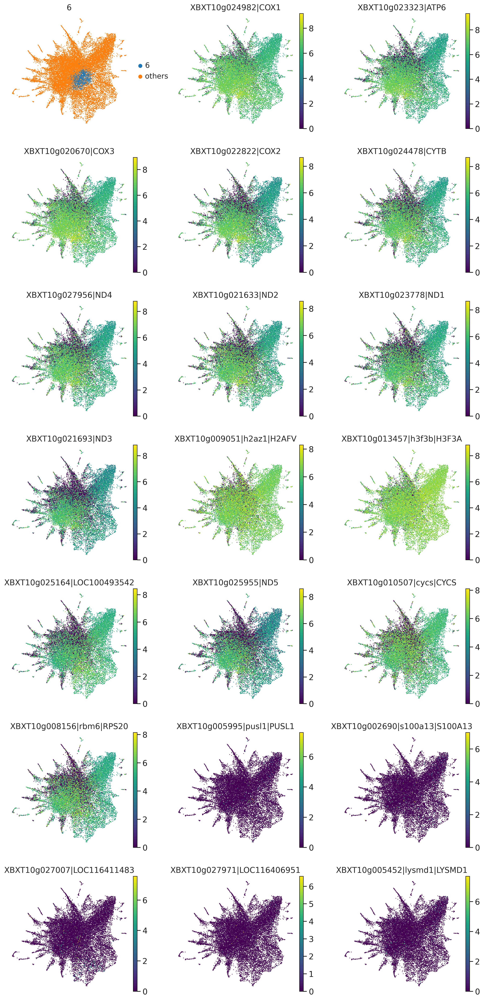

In [98]:
%matplotlib inline
sc.set_figure_params(dpi=150, scanpy=True)
num_genes = 20

adata.obs["cur_cluster"] = "others"
adata.obs.loc[adata.obs[cur_leiden] == cluster, "cur_cluster"] = cluster
colors = ["cur_cluster"] + list(marker_genes.iloc[0:num_genes, 0])
titles = [cluster] + list(marker_genes.loc[:,"gene_name_display"].iloc[0:num_genes, ])

sc.pl.umap(
    adata,
    color=colors,
    title=titles,
    frameon=False,
    ncols=3,
    use_raw=False,
    cmap='viridis',
)

# Discard some clusters

In [100]:
adata.shape

(21382, 22231)

In [101]:
# bad_clusters = ["0", ]
adata = adata[~adata.obs[cur_leiden].isin(bad_clusters), :]
# acts = acts[~acts.obs[cur_leiden].isin(bad_clusters), :]

In [102]:
adata.shape

(18040, 22231)

# Reannotation

/home/ksp503/.conda/envs/xenopus/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


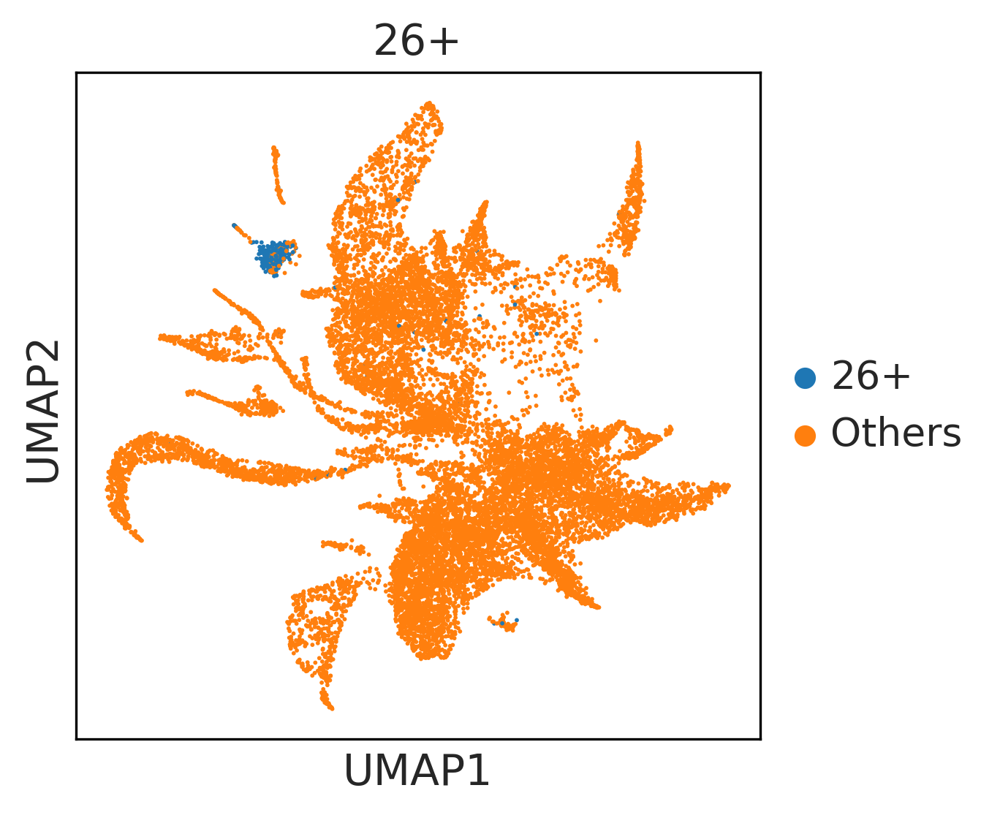

In [58]:
gene_names = ["dazl", "ddx25", "sybu"]
ad_cluster = "26+"
threshold = 6
adata.obs[ad_cluster] = "Others"
adata.obs.loc[(adata.X[:, adata.var["v9.0_gene_symbol"].isin(gene_names)].sum(axis=1) > threshold).A1, ad_cluster] = ad_cluster
sc.pl.umap(
    adata,
    color=ad_cluster,
)

In [103]:
train_target, inferred_target

('Celltype_transferred_short', 'Celltype_by_cluster')

In [104]:
cluster_celltype = {
    "9": "germ cell",
    # "36": "Spemann organizer (endoderm)"
}

adata.obs[inferred_target] = adata.obs[inferred_target].astype("str")

for cluster, cell_type in cluster_celltype.items():
    adata.obs.loc[adata.obs[cur_leiden] == cluster, inferred_target] = cell_type
    
adata.obs[inferred_target] = adata.obs[inferred_target].astype("category")

/tmp/ipykernel_2736/3864996656.py:6: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs[inferred_target] = adata.obs[inferred_target].astype("str")


In [105]:
adata.obs[inferred_target].value_counts()

Celltype_by_cluster
endoderm                        8045
neuroectoderm                   4239
marginal zone                   2682
germ cell                        911
Spemann organizer (endoderm)     868
non-neural ectoderm              864
Spemann organizer (mesoderm)     431
Name: count, dtype: int64

# Checkpoint 2

In [106]:
adata_fp = os.path.join(DATA_DIR, "adata", f"all.{NF_stage}.realigned.corrected.transferred.clustered.reannotated.h5ad")
adata.write(adata_fp)